## Background

Airbnb telah menjadi perantara utama antara pemilik properti dan para wisatawan, mengubah cara orang mencari dan menyewa tempat tinggal selama perjalanan mereka. Sebagai platform penyewaan akomodasi online yang inovatif, Airbnb memfasilitasi pemilik properti untuk memasarkan dan menyewakan ruang mereka kepada para tamu yang mencari akomodasi. Data yang tersedia mencakup informasi tentang berbagai listing yang tersedia di Bangkok, Thailand. Setiap baris dalam dataset mewakili satu listing dan kolom-kolomnya menyimpan informasi terkait seperti nama, tuan rumah, lokasi geografis, jenis kamar, harga, jumlah ulasan, dan aspek lainnya.  Kita dapat menjelajahi pola dan tren di pasar sewa properti Bangkok, seperti perbandingan harga sewa antar area, popularitas properti di berbagai lokasi, dan korelasi antara jumlah ulasan, availability, area, room type dengan harga, untuk memberikan wawasan berharga bagi pemilik properti.

## Stakeholder

Pemilik Properti Airbnb: Mereka akan tertarik untuk memahami tren dan pola dalam pasar penyewaan properti di Bangkok. Informasi tentang perbandingan harga sewa antar area, popularitas properti di berbagai lokasi, dan ketersediaan properti dari waktu ke waktu dapat membantu mereka membuat keputusan yang lebih baik terkait strategi penetapan harga, pemasaran properti, dan manajemen ketersediaan

## Problem Statement

1. Pemilik properti mungkin mengalami kesulitan dalam menentukan harga sewa yang optimal untuk properti mereka karena kurangnya pemahaman tentang perbedaan harga sewa antar area di Bangkok. Tanpa pemahaman yang cukup tentang pasar, mereka mungkin menetapkan harga sewa yang terlalu tinggi atau terlalu rendah, yang dapat berdampak pada tingkat okupansi dan keuntungan properti mereka.

1. Pemilik properti mungkin kesulitan memahami tingkat popularitas properti mereka di berbagai lokasi di Bangkok karena kurangnya akses terhadap data yang relevan. Tanpa pemahaman yang baik tentang tingkat popularitas properti, mereka mungkin mengalami kesulitan dalam mengoptimalkan strategi pemasaran dan pengelolaan properti untuk meningkatkan pendapatan dan keuntungan.

1. Pemilik properti mungkin menghadapi kesulitan dalam menentukan harga sewa yang kompetitif berdasarkan jumlah ulasan yang diterima properti mereka. Tanpa informasi yang cukup tentang korelasi antara jumlah ulasan dan harga sewa, mereka mungkin menetapkan harga yang tidak sesuai dengan tingkat popularitas properti mereka, yang dapat mengurangi daya tarik properti di pasar.

## Rumusan Masalah

1. Bagaimana perbandingan harga sewa antar area di Bangkok? Apakah terdapat perbedaan harga yang signifikan antara area-area tertentu?
1. Bagaimana tingkat popularitas properti di berbagai lokasi di Bangkok? Apakah terdapat area area tertentu yang lebih diminati oleh para penyewa listing?
<!-- 1. Bagaimana ketersediaan properti berubah dari waktu ke waktu di Bangkok? Apakah ada tren atau pola yang dapat diidentifikasi terkait ketersediaan properti selama tahun lalu? -->
1. Apakah terdapat korelasi antara jumlah ulasan, availability, area, room type dengan harga

## Goals

1. Tujuan utama adalah untuk memahami perbedaan harga sewa properti antar area di Bangkok. Hal ini akan membantu penyewa dalam memilih properti yang sesuai dengan anggaran mereka dan membantu pemilik properti dalam menetapkan harga sewa yang kompetitif.

1. Menganalisis Tingkat Popularitas Properti: Salah satu tujuan adalah untuk menganalisis tingkat popularitas properti di berbagai lokasi di Bangkok. Dengan demikian, penyewa dapat membuat keputusan berdasarkan popularitas properti tertentu, sementara pemilik properti dapat menyesuaikan strategi pemasaran mereka.
<!-- 1. Mengidentifikasi Pola Ketersediaan Properti dari Waktu ke Waktu: Tujuan lainnya adalah untuk mengidentifikasi pola ketersediaan properti dari waktu ke waktu di Bangkok. Hal ini akan membantu dalam merencanakan perjalanan dan memesan properti dengan lebih baik. -->
3. Menemukan Korelasi antara Jumlah Ulasan dan Harga Sewa: Salah satu tujuan adalah untuk menemukan korelasi antara jumlah ulasan dan harga sewa properti. Hal ini dapat memberikan wawasan tentang bagaimana harga properti mempengaruhi tingkat penerimaan dan ulasan dari penyewa.

# Data

Isi Data

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import folium
from folium.plugins import HeatMap
from folium.plugins import MarkerCluster
from scipy.stats import normaltest, chi2_contingency, mannwhitneyu, ttest_ind


import warnings
warnings.filterwarnings("ignore")



| Kolom             | Deskripsi                                      |
|-------------------|------------------------------------------------|
| `id`           | Identifikasi unik Airbnb untuk listing             |
| `name`         | Nama untuk listing yang ada di dalam Airbnb |
| `host_id`       | Identifikasi unik Airbnb untuk host/owner |
| `host_name`       | Nama pemilik listing       |
| `neighborhood`        | Lingkungan atau region tempat listing berada |
| `latitude`  | Koordinat lintang lokasi menggunakan proyeksi World Geodetic System (WGS84)                     |
| `longitude`        | Koordinat bujur lokasi menggunakan proyeksi World Geodetic System (WGS84)                |
| `room_type`      | Tipe kamar yang tersedia untuk listing         |
| `price`         | Harga listing yang telah terdaftar |
| `minimum_nights`        | Jumlah minimum malam yang diperlukan untuk memesan listing        |
| `number_of_reviews`    | Jumlah total ulasan yang diterima oleh listing                  |
| `last_review`     | Tanggal ulasan terakhir untuk listing   |
| `reviews_per_month`     | Jumlah rata-rata ulasan yang diterima oleh listing per bulan. dari mulai listing tersebut di daftarkan sampai tanggal terakhir ulasan tersebut diberikan oleh pengguna   |
| `calculated_host_listings_count`      | Jumlah semua listing yang dimiliki oleh owner |
| `availability_365`         |  Ketersediaan listing dalam 365 hari ke depan. |
| `number_of_reviews_ltm`       | Jumlah ulasan yang diterima oleh listing dalam 12 bulan terakhir            |

Berapa persentase missing value pada tiap kolom, 
- jika lebih dari 60% kolomnya bisa kita drop
- jika kurang dari 10% bisa kita drop row(list wise atau pairwise deletion)
- jika berkisar antara 10 s.d 30% bisa digunakan simple imputation(mean, median, modus) 
- jika lebih dari 30% kita bisa gunakan advanced imputation(KNN atau Regresi)

In [2]:
df=pd.read_csv('Airbnb Listings Bangkok.csv')
df.sample(3)

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
626,626,5071188,cosy and convenience @ heart of BKK,21621627,Narsaraet,Bang Rak,13.72276,100.53120,Entire home/apt,4000,2,16,2017-05-21,0.17,1,272,0
5410,5410,27206517,"NEW, AMAZING POOL! BTS! FREE WIFI!",122218079,Ario,Khlong Toei,13.71240,100.59417,Private room,999,180,1,2018-12-26,0.02,1,365,0
11987,11987,53139494,"Lovely Studio near Bangkok Hospital, RCA, Wifi.",7278395,Niramol,Huai Khwang,13.74947,100.58381,Entire home/apt,800,7,3,2022-07-01,0.32,8,317,3


In [3]:
# pd.set_option('display.max_rows',None)
pd.set_option('display.max_columns',None)
pd.set_option('display.max_colwidth',None)

def unique_data(df):
    data_unique = pd.DataFrame()
    data_unique['Columns'] = df.columns
    data_unique['Unique Count'] = [df[col].nunique() for col in (df.columns)]
    data_unique['Unique'] = [df[col].unique()[:5] for col in (df.columns)]  
    return data_unique


unique_data(df)

,Columns,Unique Count,Unique
0,Unnamed: 0,15854,"[0, 1, 2, 3, 4]"
1,id,15854,"[27934, 27979, 28745, 35780, 941865]"
2,name,14794,"[Nice room with superb city view, Easy going landlord,easy place, modern-style apartment in Bangkok, Spacious one bedroom at The Kris Condo Bldg. 3, Suite Room 3 at MetroPoint]"
3,host_id,6659,"[120437, 120541, 123784, 153730, 610315]"
4,host_name,5312,"[Nuttee, Emy, Familyroom, Sirilak, Kasem]"
5,neighbourhood,50,"[Ratchathewi, Bang Na, Bang Kapi, Din Daeng, Bang Kho laen]"
6,latitude,9606,"[13.75983, 13.66818, 13.75232, 13.78823, 13.76872]"
7,longitude,10224,"[100.54134, 100.61674, 100.62402, 100.57256, 100.63338]"
8,room_type,4,"[Entire home/apt, Private room, Hotel room, Shared room]"
9,price,3040,"[1905, 1316, 800, 1286, 1000]"


In [4]:
df.drop(columns=['Unnamed: 0'],inplace=True)
df.head()

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,27934,Nice room with superb city view,120437,Nuttee,Ratchathewi,13.75983,100.54134,Entire home/apt,1905,3,65,2020-01-06,0.50,2,353,0
1,27979,"Easy going landlord,easy place",120541,Emy,Bang Na,13.66818,100.61674,Private room,1316,1,0,NaN,NaN,2,358,0
2,28745,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.75232,100.62402,Private room,800,60,0,NaN,NaN,1,365,0
3,35780,Spacious one bedroom at The Kris Condo Bldg. 3,153730,Sirilak,Din Daeng,13.78823,100.57256,Private room,1286,7,2,2022-04-01,0.03,1,323,1
4,941865,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.76872,100.63338,Private room,1905,1,0,NaN,NaN,3,365,0


In [5]:
#mencari outliers bisa menggunakan boxplot, untuk handle outliers bisa di drop
display(df.describe(), df.describe(include='object'))

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
count,1.585400e+04,1.585400e+04,15854.000000,15854.000000,1.585400e+04,15854.000000,15854.000000,10064.000000,15854.000000,15854.000000,15854.000000
mean,1.579397e+17,1.541058e+08,13.745144,100.559903,3.217704e+03,15.292355,16.654157,0.813145,13.889618,244.378643,3.481519
std,2.946015e+17,1.318726e+08,0.043040,0.050911,2.497212e+04,50.815020,40.613331,1.090196,30.269848,125.843224,8.916937
min,2.793400e+04,5.892000e+04,13.527300,100.329550,0.000000e+00,1.000000,0.000000,0.010000,1.000000,0.000000,0.000000
25%,2.104509e+07,3.974431e+07,13.720090,100.529690,9.000000e+02,1.000000,0.000000,0.120000,1.000000,138.000000,0.000000
50%,3.503734e+07,1.224556e+08,13.738490,100.561415,1.429000e+03,1.000000,2.000000,0.435000,4.000000,309.000000,0.000000
75%,5.256154e+07,2.390547e+08,13.759497,100.585150,2.429000e+03,7.000000,13.000000,1.060000,13.000000,360.000000,3.000000
max,7.908162e+17,4.926659e+08,13.953540,100.923440,1.100000e+06,1125.000000,1224.000000,19.130000,228.000000,365.000000,325.000000


,name,host_name,neighbourhood,room_type,last_review
count,15846,15853,15854,15854,10064
unique,14794,5312,50,4,1669
top,New! La Chada Night Market studio 2PPL near MRT,Curry,Vadhana,Entire home/apt,2022-12-11
freq,45,228,2153,8912,189


In [6]:
df.groupby(['minimum_nights'])['price'].median()

minimum_nights
1       1500.0
2       1558.0
3       1500.0
4       1450.0
5       1558.0
         ...  
999     8228.5
1000     650.0
1095     554.0
1115    2000.0
1125    2900.0
Name: price, Length: 86, dtype: float64

In [7]:
df[df['availability_365']==0].head()

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
51,1019241,Chic two bedroom for Monthly rental,3323622,Phoebe,Bang Rak,13.72687,100.52725,Entire home/apt,2701,30,104,2020-02-20,0.89,1,0,0
61,1041976,Long-stay special rate spacious entire floor Siam,5735895,Pariya,Parthum Wan,13.74814,100.52016,Entire home/apt,2900,1125,295,2021-08-21,2.61,3,0,0
104,527553,"Beautiful Apt @ Ratchayothin BTS, Free Wifi",2592798,Nokina,Chatu Chak,13.82841,100.57103,Entire home/apt,1004,2,24,2018-07-22,0.19,2,0,0
141,1244333,"Private Room@Chatuchak,BTS,JJ market,DMK airport",2087671,Apipu,Phaya Thai,13.79221,100.54631,Private room,399,1,33,2020-03-15,0.78,1,0,0
152,1316688,Contemporary Modern Duplex - Thonglor,5394070,Eva,Khlong Toei,13.72242,100.57962,Entire home/apt,1489,30,81,2022-10-07,0.72,1,0,3


## Handling Missing Value

In [8]:
round(df.isna().sum()*100/len(df),2).astype(str)+'%'
# df.info()

id                                  0.0%
name                               0.05%
host_id                             0.0%
host_name                          0.01%
neighbourhood                       0.0%
latitude                            0.0%
longitude                           0.0%
room_type                           0.0%
price                               0.0%
minimum_nights                      0.0%
number_of_reviews                   0.0%
last_review                       36.52%
reviews_per_month                 36.52%
calculated_host_listings_count      0.0%
availability_365                    0.0%
number_of_reviews_ltm               0.0%
dtype: object

Cara untuk menangani missing value:

Pertama untuk kolom name yang memiliki missing value dengan nilai 0.05% dan kita juga harus cek missing valuenya terlebih dahulu. Lalu kita dapat menangani missing value tersebut dengan drop jika ingin tidak digunakan.

Kedua untuk kolom host_name yang memiliki missing value dengan nilai 0.01% dan kita juga harus cek missing valuenya terlebih dahulu. Lalu kita dapat menangani missing value tersebut dengan drop jika ingin tidak digunakan.

Ketiga untuk kolom last_review dan review_per_month karena nilai missing value cukup besar yaitu 36.52%, kita dapat mengisi missing value tersebut dengan nilai 0.

In [9]:
df[(df['reviews_per_month']==0)]

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm


In [10]:
#Metode .isin() digunakan untuk memeriksa apakah nilai-nilai dalam suatu kolom terdapat dalam suatu himpunan nilai yang diberikan. 
#Ini berguna ketika Anda ingin memfilter baris-baris DataFrame berdasarkan beberapa nilai yang spesifik.
host_ids = [73275200, 55347997, 51374914, 42521288, 31895202, 22030043, 24386225, 18852579]
filtered_df = df[df['host_id'].isin(host_ids)]
filtered_df

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
439,4549768,NaN,18852579,Titawan,Phra Khanong,13.69406,100.59619,Private room,1080,5,0,NaN,NaN,1,365,0
544,4720818,NaN,24386225,Cherry,Din Daeng,13.77562,100.57346,Private room,1200,1,0,NaN,NaN,1,365,0
572,4245018,NaN,22030043,Parichart,Bang Phlat,13.78376,100.49821,Private room,1200,1,0,NaN,NaN,1,365,0
669,6148415,NaN,31895202,Chira,Bang Na,13.68276,100.60894,Entire home/apt,2424,2,0,NaN,NaN,1,365,0
1030,8055144,NaN,42521288,Nantida,Vadhana,13.74126,100.55761,Private room,5000,3,0,NaN,NaN,1,365,0
1282,10000742,NaN,51374914,Diamond Bangkok,Ratchathewi,13.75328,100.52928,Private room,930,1,6,2017-05-13,0.07,1,365,0
1594,10710165,NaN,55347997,Khaneungnit,Vadhana,13.71757,100.60464,Private room,1000,1,0,NaN,NaN,1,365,0
1981,13400326,Errday Guest House,73275200,Pakaphol,Khlong Toei,13.72427,100.56443,Private room,950,1,1,2020-02-19,0.03,3,1,0
1982,13400758,Errday Guest House,73275200,Pakaphol,Khlong Toei,13.72373,100.56415,Private room,36363,1,0,NaN,NaN,3,1,0
2075,13142743,NaN,73275200,Pakaphol,Khlong Toei,13.72566,100.56416,Private room,850,1,2,2017-12-11,0.03,3,220,0


Setelah kita cek host_id dari missing value yang ada pada kolom name maka kita akan menemukan 1 `host_id` yang memiliki jumlah listing sebanyak 3 tetapi ada satu tidak ada namanya yaitu `host_id==73275200`. Maka kita akan mengisi missing value `name` tersebut dengan `Errday Guest House` sesuai dengan 2 data yang sudah memiliki nama

In [11]:
df.at[2075, 'name'] = "Errday Guest House"

In [12]:
df[df['host_id']==73275200]

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
1981,13400326,Errday Guest House,73275200,Pakaphol,Khlong Toei,13.72427,100.56443,Private room,950,1,1,2020-02-19,0.03,3,1,0
1982,13400758,Errday Guest House,73275200,Pakaphol,Khlong Toei,13.72373,100.56415,Private room,36363,1,0,NaN,NaN,3,1,0
2075,13142743,Errday Guest House,73275200,Pakaphol,Khlong Toei,13.72566,100.56416,Private room,850,1,2,2017-12-11,0.03,3,220,0


In [13]:
df[df['name'].isna()]

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
439,4549768,NaN,18852579,Titawan,Phra Khanong,13.69406,100.59619,Private room,1080,5,0,NaN,NaN,1,365,0
544,4720818,NaN,24386225,Cherry,Din Daeng,13.77562,100.57346,Private room,1200,1,0,NaN,NaN,1,365,0
572,4245018,NaN,22030043,Parichart,Bang Phlat,13.78376,100.49821,Private room,1200,1,0,NaN,NaN,1,365,0
669,6148415,NaN,31895202,Chira,Bang Na,13.68276,100.60894,Entire home/apt,2424,2,0,NaN,NaN,1,365,0
1030,8055144,NaN,42521288,Nantida,Vadhana,13.74126,100.55761,Private room,5000,3,0,NaN,NaN,1,365,0
1282,10000742,NaN,51374914,Diamond Bangkok,Ratchathewi,13.75328,100.52928,Private room,930,1,6,2017-05-13,0.07,1,365,0
1594,10710165,NaN,55347997,Khaneungnit,Vadhana,13.71757,100.60464,Private room,1000,1,0,NaN,NaN,1,365,0


Kita akan menangani missing value pada kolom name yang tidak dapat diubah karena tidak memiliki data serupa yang dapat dijadikan acuan dengan melakukan drop.

In [14]:
df.dropna(subset=['name'],inplace=True)
df[df['name'].isna()]

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm


In [15]:
df[df['host_name'].isna()]

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
3571,19682464,Cozy Hideaway,137488762,NaN,Bang Kapi,13.76999,100.63769,Private room,1399,3,1,2017-07-29,0.02,1,365,0


In [16]:
df[df['host_id']==137488762]

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
3571,19682464,Cozy Hideaway,137488762,NaN,Bang Kapi,13.76999,100.63769,Private room,1399,3,1,2017-07-29,0.02,1,365,0


Kita akan menangani missing value pada kolom host_name yang tidak dapat diubah karena tidak memiliki data serupa yang dapat dijadikan acuan dengan melakukan drop.

In [17]:
df.dropna(subset=['host_name'],inplace=True)
df[df['host_name'].isna()]

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm


In [18]:
df['last_review'] = df['last_review'].fillna('Not Reviewed')
df['reviews_per_month'] = df['reviews_per_month'].fillna(0)

Mengganti NaN kolom last_review & reviews_per_month dengan `Not Reviewed` & 0

In [19]:
round(df.isna().sum()*100/len(df),2).astype(str)+'%'

id                                0.0%
name                              0.0%
host_id                           0.0%
host_name                         0.0%
neighbourhood                     0.0%
latitude                          0.0%
longitude                         0.0%
room_type                         0.0%
price                             0.0%
minimum_nights                    0.0%
number_of_reviews                 0.0%
last_review                       0.0%
reviews_per_month                 0.0%
calculated_host_listings_count    0.0%
availability_365                  0.0%
number_of_reviews_ltm             0.0%
dtype: object

# Handling Duplicate Data

In [20]:
duplicates=df.duplicated()
df[duplicates]

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm


In [21]:
#dari data pada kolom tersebut dapat kita temukan duplikat data yang dapat kita analisis lagi
duplicate_rows = df[df.duplicated(subset=['name','longitude', 'latitude', 'price', 'last_review'])]
duplicate_rows

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
5976,28907857,NA BANGLAMPOO GUEST HOUSE,87704107,Yui,Phra Nakhon,13.762790,100.497900,Private room,1400,1,0,Not Reviewed,0.0,9,361,0
8790,37954129,small1,97598307,Soo,Don Mueang,13.920720,100.575780,Shared room,350,1,0,Not Reviewed,0.0,4,180,0
15121,767128654727724698,Sathon Luxury Loft/China Town/Icon Siam,276781306,Alex,Sathon,13.710777,100.519891,Entire home/apt,1580,1,0,Not Reviewed,0.0,13,339,0
15144,767945912006659422,Sathon Luxury Loft/China Town/Icon Siam,344327171,Alice,Sathon,13.710777,100.519891,Entire home/apt,1580,1,0,Not Reviewed,0.0,40,339,0
15186,765691389894680033,Sathon Luxury 2 br/China Town/Icon Siam,264864968,Tricia,Sathon,13.710777,100.519891,Entire home/apt,2221,1,0,Not Reviewed,0.0,44,340,0
15190,765716244664642439,Sathon Luxury 2 br/China Town/Icon Siam,344327171,Alice,Sathon,13.710777,100.519891,Entire home/apt,2221,1,0,Not Reviewed,0.0,40,340,0
15191,765721954905526928,Sathon Luxury 2 br/China Town/Icon Siam,344327171,Alice,Sathon,13.710777,100.519891,Entire home/apt,2221,1,0,Not Reviewed,0.0,40,340,0
15192,765728211212001811,Sathon Luxury 2 br/China Town/Icon Siam,276781306,Alex,Sathon,13.710777,100.519891,Entire home/apt,2221,1,0,Not Reviewed,0.0,13,340,0
15195,765781484209218358,Sathon Luxury 2 br/China Town/Icon Siam,20133201,Willam,Sathon,13.710777,100.519891,Entire home/apt,2221,1,0,Not Reviewed,0.0,33,340,0
15371,775777794097427183,New! Gateway/ Bangkok University 1BR 2PPL near BTS,52161947,Noons,Khlong Toei,13.716669,100.584967,Entire home/apt,2976,1,0,Not Reviewed,0.0,99,362,0


In [22]:
df[df['name']=='Sathon Luxury Loft/China Town/Icon Siam']

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
15120,767112544721073364,Sathon Luxury Loft/China Town/Icon Siam,276781306,Alex,Sathon,13.710777,100.519891,Entire home/apt,1580,1,0,Not Reviewed,0.0,13,326,0
15121,767128654727724698,Sathon Luxury Loft/China Town/Icon Siam,276781306,Alex,Sathon,13.710777,100.519891,Entire home/apt,1580,1,0,Not Reviewed,0.0,13,339,0
15122,767135411173964009,Sathon Luxury Loft/China Town/Icon Siam,344327171,Alice,Sathon,13.711600,100.518720,Entire home/apt,1580,1,0,Not Reviewed,0.0,40,339,0
15144,767945912006659422,Sathon Luxury Loft/China Town/Icon Siam,344327171,Alice,Sathon,13.710777,100.519891,Entire home/apt,1580,1,0,Not Reviewed,0.0,40,339,0
15146,767957513670782922,Sathon Luxury Loft/China Town/Icon Siam,20133201,Willam,Sathon,13.709990,100.519330,Entire home/apt,1580,1,0,Not Reviewed,0.0,33,339,0


In [23]:
df[df['name']=='NA BANGLAMPOO GUEST HOUSE']

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
5890,28831409,NA BANGLAMPOO GUEST HOUSE,87704107,Yui,Phra Nakhon,13.76279,100.49790,Private room,1400,1,0,Not Reviewed,0.00,9,361,0
5892,28832370,NA BANGLAMPOO GUEST HOUSE,87704107,Yui,Phra Nakhon,13.76162,100.49768,Private room,750,1,16,2020-02-18,0.32,9,360,0
5976,28907857,NA BANGLAMPOO GUEST HOUSE,87704107,Yui,Phra Nakhon,13.76279,100.49790,Private room,1400,1,0,Not Reviewed,0.00,9,361,0


In [24]:
df.drop_duplicates(subset=['name', 'longitude', 'latitude', 'price', 'last_review'], inplace=True)

Dari sini kita dapat simpulkan bahwa ada beberapa data memiliki duplikat data, maka kita akan melakukan drop pada kolom data yang terduplikat

In [25]:
total_listing = len(df)
available_listing = df[df['availability_365'] > 0]
percentage_available = len(available_listing) / total_listing * 100

print(f"Persentase ketersediaan listing: {percentage_available:.2f}%")

Persentase ketersediaan listing: 94.59%


# Handling Outliers

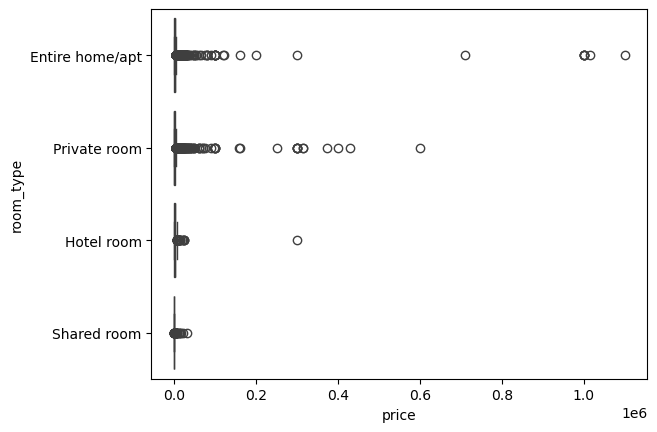

In [26]:
sns.boxplot(data = df,x='price', y='room_type')
plt.show()

In [27]:
#menghapus harga penginapan yang harga=0 dengan menggunakan fungsi drop
#karena tidak memungkinkan jika ada penginapan yang ada di data airbnb dengan harga 0
df_cleaned = df.drop(df[df['price'] == 0].index,inplace=True)

In [28]:
#Outliers
df[df['price']==0]

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm


In [29]:
df_apart=df[df['room_type']=='Entire home/apt'].sort_values('price',ascending=False)
df_prvt=df[df['room_type']=='Private room'].sort_values('price',ascending=False)

display(df_apart.head())
display(df_prvt.head())

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
12868,635676064543597376,New 1 bedroom apartment BTS MRT Asoke,12464705,Lucio,Vadhana,13.742186,100.560394,Entire home/apt,1100000,14,0,Not Reviewed,0.00,1,365,0
12300,562972065309061724,3B中文No Guest Service Fee@Nana Asok/Soi11 Nightlife,131427125,Jj,Vadhana,13.746660,100.559100,Entire home/apt,1014758,30,2,2022-09-17,0.32,10,75,2
4620,23740993,"Modern&Luxury apartment,5min to MRT,freeWifi",30803267,Yasmine,Huai Khwang,13.760650,100.568980,Entire home/apt,1000000,1,12,2020-03-24,0.22,4,336,0
1239,8880974,"Modern,wifi,5m MRT&2 Shopping Mall",30803267,Yasmine,Huai Khwang,13.759950,100.569360,Entire home/apt,1000000,100,45,2016-09-05,0.51,4,180,0
1779,11579635,"2 Bedroom,wifi,5mMRT&Shopping Mall",30803267,Yasmine,Huai Khwang,13.754710,100.565980,Entire home/apt,1000000,100,53,2018-02-20,0.64,4,249,0


,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
4373,22633450,rm 1 : cozy & comfy,117057915,Jeab,Bang Phlat,13.79163,100.49038,Private room,600700,1,9,2020-01-26,0.17,5,330,0
11885,52940323,🎗𝘾𝙝𝙚𝙬𝙖𝙩𝙝𝙖𝙞 𝙍𝙖𝙢𝙠𝙝𝙖𝙢𝙝𝙖𝙚𝙣𝙜\nBy KhunGrape,99882630,Jiranuch,Bang Kapi,13.76082,100.63366,Private room,429443,1,0,Not Reviewed,0.00,1,313,0
12792,629653142142561774,rm 6 : bright morning sunlight.,117057915,Jeab,Bang Phlat,13.79049,100.48816,Private room,400717,1,0,Not Reviewed,0.00,5,241,0
6549,31365769,"WH (container, Double bed, 2ppl -F)",234881965,Napawadee,Khlong Toei,13.73514,100.55217,Private room,372227,1,24,2020-01-27,0.50,4,147,0
6760,31364368,"WH (Container style, twin bed, 2ppl, citycenter-A)",234881965,Napawadee,Khlong Toei,13.73505,100.55239,Private room,314899,1,4,2020-02-24,0.10,4,147,0


In [30]:
Q3 = df['price'].quantile(0.75)
Q1 = df['price'].quantile(0.25)
IQR = Q3 - Q1
IQR

1529.0

In [31]:
upper_bound = Q3 + (1.5 * IQR)
upper_bound

4722.5

In [32]:
count_above_4722 = (df['price'] > 4722.5).sum()
print("Jumlah baris dengan harga di atas 4722.5:", count_above_4722)

Jumlah baris dengan harga di atas 4722.5: 1402


In [33]:
drop_data=1402/15853*100
print(f' Persentase data yang akan di drop {drop_data} %')

 Persentase data yang akan di drop 8.843751971235728 %


Disini kita akan drop kolom price dengan harga diatas 4722.5 sebesar 8.84% data karena terindikasi sebagai outlier dan jumlah data yang akan di drop masih dibawah 20%, maka dari itu kita akan melakukan drop pada data tersebut.

In [34]:
df.drop(df[df['price'] > 4722.5].index, inplace=True)
df.reset_index(inplace=True)

In [35]:
df['room_type'].value_counts()

room_type
Entire home/apt    8095
Private room       5273
Hotel room          553
Shared room         508
Name: count, dtype: int64

Membuat kolom baru `Area` agar dapat lebih mudah memetakan lokasi penginapan di Bangkok

In [36]:
area_mapping = {
    'Bang Sue': 'North Bangkok',
    'Lak Si': 'North Bangkok',
    'Sai Mai': 'North Bangkok',
    'Chatu Chak' : 'North Bangkok',
    'Don Mueang': 'North Bangkok',
    'Bang Khen': 'North Bangkok',
    'Chatuchak': 'North Bangkok',
    'Bang Kapi': 'East Bangkok',
    'Lat Krabang': 'East Bangkok',
    'Wang Thong Lang': 'East Bangkok',
    'Nong Chok': 'East Bangkok',
    'Bueng Kum': 'East Bangkok',
    'Min Buri': 'East Bangkok',
    'Saphan Sung' :'East Bangkok',
    'Khlong Sam Wa': 'East Bangkok',
    'Lat Phrao' : 'East Bangkok',
    'Khan Na Yao': 'East Bangkok',
    'Bangkok Yai': 'West Bangkok',
    'Khlong San' : 'West Bangkok',
    'Thon buri' : 'West Bangkok',
    'Thon Buri': 'West Bangkok',
    'Thung khru': 'West Bangkok',
    'Bang Phlat': 'West Bangkok',
    'Taling Chan': 'West Bangkok',
    'Phasi Charoen': 'West Bangkok',
    'Bang Khae': 'West Bangkok',
    'Bangkok Noi': 'West Bangkok',
    'Sathon': 'South Bangkok',
    'Phra Khanong' : 'South Bangkok',
    'Yan Nawa': 'South Bangkok',
    'Suanluang': 'South Bangkok',
    'Bang Na' : 'South Bangkok',
    'Bang Kho laen' : 'South Bangkok',
    'Bang Kho Laem': 'South Bangkok',
    'Rat Burana': 'South Bangkok',
    'Yan na wa': 'South Bangkok',
    'Ratchathewi': 'Central Bangkok',
    'Pra Wet' : 'Central Bangkok',
    'Parthum Wan': 'Central Bangkok',
    'Din Daeng': 'Central Bangkok',
    'Khlong Toei': 'Central Bangkok',
    'Phaya Thai': 'Central Bangkok',
    'Vadhana': 'Central Bangkok',
    'Huai Khwang': 'Central Bangkok',
    'Bang Rak': 'Central Bangkok',
    'Pathum Wan': 'Central Bangkok',
    'Phra Nakhon': 'Central Bangkok',
    'Dusit': 'Central Bangkok',
    'Pom Prap Sattru Phai': 'Central Bangkok',
    'Samphanthawong': 'Central Bangkok',
    'Bang Bon': 'Outer Western Bangkok',
    'Chom Thong': 'Outer Western Bangkok',
    'Thawi Watthana': 'Outer Western Bangkok',
    'Bang Khun thain': 'Outer Western Bangkok',
    'Nong Khaem': 'Outer Western Bangkok'
}

df['area'] = df['neighbourhood'].map(area_mapping)
df.sample(5)

,index,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,area
6164,6744,31679152,small2,97598307,Soo,Don Mueang,13.91525,100.58530,Private room,1200,1,0,Not Reviewed,0.0,4,180,0,North Bangkok
298,321,3704045,"Kid-friendly, Amazing Views Bangkok",2545448,Achara,Bang Na,13.68401,100.61513,Entire home/apt,1905,2,60,2022-12-20,0.6,1,326,10,South Bangkok
1592,1698,11471899,Apartment for rent in Bangkok,60357735,Rat,Vadhana,13.73975,100.58551,Entire home/apt,800,365,0,Not Reviewed,0.0,1,365,0,Central Bangkok
11628,12756,625972600089069497,Cozy 1bedroom with river view 30FL/39m²,458715536,Nc,Sathon,13.71198,100.53538,Entire home/apt,1429,7,0,Not Reviewed,0.0,9,303,0,South Bangkok
13110,14411,731593937554078452,无边泳池/rama9精品studio/新火车夜市/中国大使馆/rca酒吧街,20133201,Willam,Ratchathewi,13.75303,100.56417,Entire home/apt,1327,7,0,Not Reviewed,0.0,33,359,0,Central Bangkok


In [37]:
#1 tidak populer : avail365 besar, 0 populer : avail 365 kecil
df['popularity']=np.where(df['availability_365']<=0.4*df['availability_365'].median(),'Very Popular',
                          np.where(df['availability_365']<=0.6*df['availability_365'].median(),'Popular','Non Popular'))

In [38]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14429 entries, 0 to 14428
Data columns (total 19 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   index                           14429 non-null  int64  
 1   id                              14429 non-null  int64  
 2   name                            14429 non-null  object 
 3   host_id                         14429 non-null  int64  
 4   host_name                       14429 non-null  object 
 5   neighbourhood                   14429 non-null  object 
 6   latitude                        14429 non-null  float64
 7   longitude                       14429 non-null  float64
 8   room_type                       14429 non-null  object 
 9   price                           14429 non-null  int64  
 10  minimum_nights                  14429 non-null  int64  
 11  number_of_reviews               14429 non-null  int64  
 12  last_review                     

In [39]:
df.sample(10)

,index,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,area,popularity
11342,12449,559656037528038108,Enjoy Comfy Stay for 4 @ The Little Pig Sukhumvit,337002776,Zuzu,Khlong Toei,13.715200,100.588870,Private room,2009,1,0,Not Reviewed,0.00,30,363,0,Central Bangkok,Non Popular
5700,6219,30276951,Bann Nai Krai (บ้านนายไกร) Luxury Thai Home,151626808,Tanavee,Thawi Watthana,13.764050,100.347760,Private room,500,1,6,2020-02-17,0.13,1,89,0,Outer Western Bangkok,Very Popular
314,337,3716321,Comfort Condominium in Center BKK,7955610,Coco,Din Daeng,13.759410,100.555710,Private room,1500,3,0,Not Reviewed,0.00,2,365,0,Central Bangkok,Non Popular
14236,15648,777910166021639318,Utd Living Loft 24Sqm,112794861,Yair,Suanluang,13.708700,100.617130,Private room,1200,28,0,Not Reviewed,0.00,5,364,0,South Bangkok,Non Popular
2971,3181,18192274,HOFT Hostel 5 Mins from BTS : 1-B in 8-B Mixed Rm,121527000,Alan,Bang Rak,13.726950,100.523100,Shared room,340,1,0,Not Reviewed,0.00,6,365,0,Central Bangkok,Non Popular
3406,3652,19943259,"Nice, clean and cozy apartment room 203",141332574,Boonchawee,Bang Kapi,13.763950,100.653680,Private room,1229,1,0,Not Reviewed,0.00,3,181,0,East Bangkok,Popular
3499,3756,20559597,Classy room near BTS Bearing walk 3 mins. 350 m.,15125913,Patcharawee,Bang Na,13.661376,100.605782,Entire home/apt,950,60,0,Not Reviewed,0.00,1,362,0,South Bangkok,Non Popular
11154,12239,546348518069941431,Best view condo - very close to the BTS skytrain,147148195,Thanisorn,Thon buri,13.720440,100.492340,Entire home/apt,1339,4,13,2022-12-27,1.53,1,44,13,West Bangkok,Very Popular
3511,3769,20179768,Close to BTS Wong Wian Yai,123194331,Emon,Thon buri,13.715000,100.491920,Private room,2200,7,0,Not Reviewed,0.00,1,365,0,West Bangkok,Non Popular
2218,2379,15046641,Double Bed room,78215647,Khaosan,Phra Nakhon,13.759610,100.497460,Private room,1290,1,2,2017-04-30,0.03,3,0,0,Central Bangkok,Very Popular


# Data Analysis

## 1. Rata-Rata Harga Sewa Tempat Penginapan Berdasarkan Area di Bangkok

In [40]:
price_mean = round(df['price'], 2).mean()
price_mean

1563.3588606279022

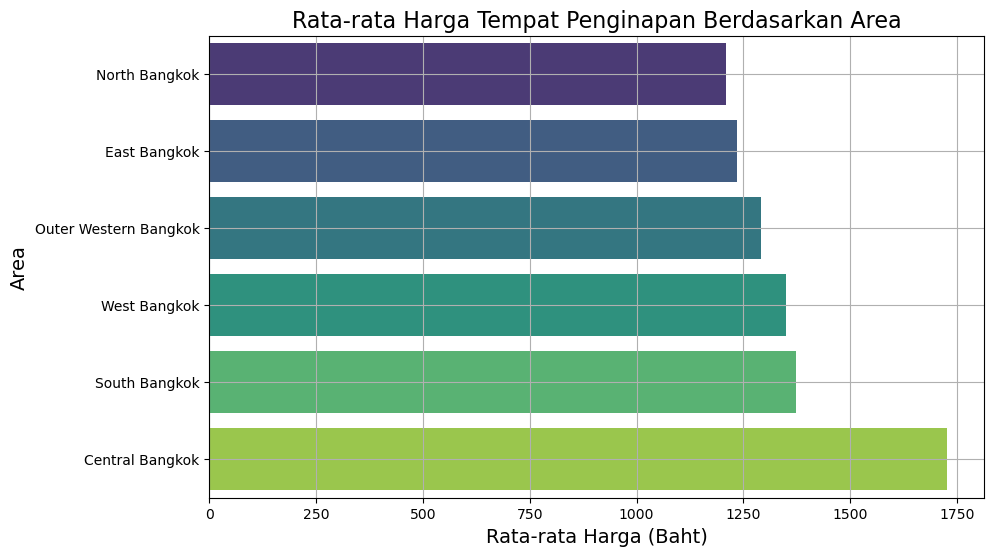

In [41]:
# Groupby berdasarkan 'area' dan menghitung rata-rata harga
area_price = df.groupby('area')['price'].mean().reset_index()

# Plot bar
plt.figure(figsize=(10, 6))
sns.barplot(data=area_price.sort_values(by='price'), x='price', y='area', palette='viridis')
plt.xlabel('Rata-rata Harga (Baht)', fontsize=14)
plt.ylabel('Area', fontsize=14)
plt.title('Rata-rata Harga Tempat Penginapan Berdasarkan Area', fontsize=16)
plt.grid(True)
plt.show()

In [42]:
# Groupby berdasarkan 'area' dan menghitung standar deviasi harga
std_dev_price = df.groupby('area')['price'].std().reset_index()

# Membulatkan standar deviasi ke dua desimal
std_dev_price['price'] = std_dev_price['price'].round(2)

# Menampilkan hasil standar deviasi
print(std_dev_price)

                    area   price
0        Central Bangkok  963.93
1           East Bangkok  879.52
2          North Bangkok  788.66
3  Outer Western Bangkok  780.00
4          South Bangkok  842.41
5           West Bangkok  902.99


Dari hasil perhitungan standar deviasi harga berdasarkan area di Bangkok, kita dapat menarik beberapa kesimpulan sebagai berikut:

Central Bangkok memiliki standar deviasi harga tertinggi sebesar 963.93 Baht. Hal ini menunjukkan bahwa ada variasi yang sangat tinggi dalam harga sewa penginapan di daerah ini, mungkin karena Central Bangkok mencakup berbagai jenis penginapan dari yang sangat mewah hingga yang lebih ekonomis.

East Bangkok memiliki standar deviasi harga sebesar 879.52 Baht, yang juga menunjukkan variasi harga yang signifikan, tetapi sedikit lebih rendah dibandingkan Central Bangkok. Ini menunjukkan bahwa area ini juga memiliki beragam jenis penginapan.

West Bangkok menunjukkan variasi harga yang cukup tinggi dengan standar deviasi sebesar 902.99 Baht, yang berarti ada fluktuasi harga yang cukup signifikan di wilayah ini.

South Bangkok memiliki standar deviasi harga sebesar 842.41 Baht. Ini menunjukkan variasi harga yang cukup besar di wilayah ini, meskipun sedikit lebih rendah daripada East dan West Bangkok.

North Bangkok dan Outer Western Bangkok memiliki standar deviasi harga yang lebih rendah, masing-masing sebesar 788.66 Baht dan 780.00 Baht. Ini menunjukkan bahwa variasi harga di daerah-daerah ini sedikit lebih terkendali dibandingkan dengan area lainnya.

## 2. Tingkat Popularitas Properti di Berbagai Lokasi di Bangkok

argumen
tingkat popularitas berdasarkan area

kenapa tidak pakai number of review untuk popularitas, kemarin dilema juga number of review juga kemarin di cek korelasinya mereka berdua cukup tinggi jadi kita pakai salah satu pun gamasalah. Availibilty 365 itu popularity terbaru untuk tahun yang akan datang sedangkan number_of_review itu di tahun kebelakang

<Axes: xlabel='availability_365', ylabel='Count'>

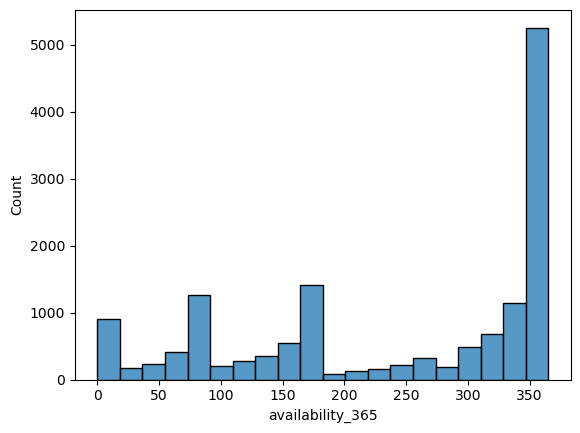

In [43]:
sns.histplot(data=df,x='availability_365')

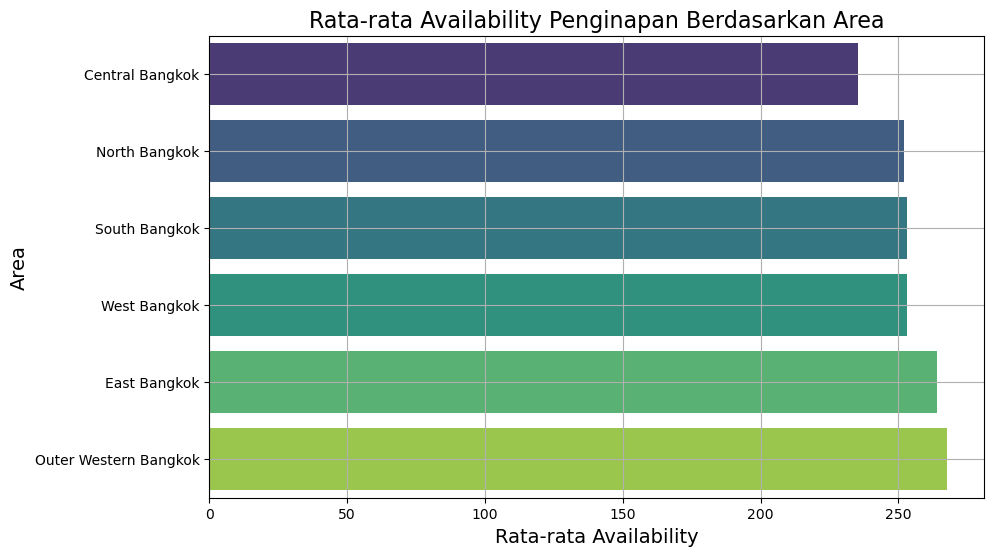

In [44]:
# Groupby berdasarkan 'room_type' dan menghitung rata-rata harga
roomtype_price = df.groupby('area')['availability_365'].mean().reset_index()

# Plot bar
plt.figure(figsize=(10, 6))
sns.barplot(data=roomtype_price.sort_values(by='availability_365'), x='availability_365', y='area', palette='viridis')
plt.xlabel('Rata-rata Availability', fontsize=14)
plt.ylabel('Area', fontsize=14)
plt.title('Rata-rata Availability Penginapan Berdasarkan Area', fontsize=16)
plt.grid(True)
plt.show()

Dari visualisasi tersebut, dapat diambil beberapa insight penting mengenai rata-rata ketersediaan penginapan berdasarkan area di Bangkok:

Perbedaan Rata-rata Ketersediaan:

1. Penginapan di Central Bangkok memiliki rata-rata ketersediaan yang paling rendah dibandingkan dengan area lainnya. Ini mungkin menunjukkan bahwa penginapan di pusat kota cukup populer dan lebih sering dipesan.
1. Sebaliknya, penginapan di Outer Western Bangkok memiliki rata-rata ketersediaan yang tertinggi. Ini bisa mengindikasikan bahwa penginapan di area ini kurang populer atau memiliki permintaan yang lebih rendah dibandingkan area lainnya.
    
Distribusi Ketersediaan di Area Lainnya:

1. Area seperti North Bangkok, South Bangkok, West Bangkok, dan East Bangkok memiliki rata-rata ketersediaan yang lebih seimbang dan berada di tengah-tengah spektrum antara Central Bangkok dan Outer Western Bangkok.
1. Perbedaan ketersediaan antar area tersebut tidak terlalu signifikan dibandingkan dengan Central dan Outer Western Bangkok, namun tetap menunjukkan adanya variasi dalam permintaan penginapan di berbagai bagian kota.

In [60]:
# Membuat peta dengan koordinat pusat Bangkok
map_bangkok = folium.Map(location=[13.7563, 100.5018], zoom_start=11)

# Membuat cluster marker
marker_cluster = MarkerCluster().add_to(map_bangkok)

# Iterasi setiap baris DataFrame
for index, row in df.iterrows():
    # Menentukan warna marker berdasarkan tingkat popularitas
    if row['popularity'] == 'Very Popular':
        color = 'red'
    elif row['popularity'] == 'Popular':
        color = 'orange'
    else:
        color = 'green'
    
    # Menambahkan marker pada peta
    folium.Marker(location=[row['latitude'], row['longitude']], 
                  popup=row['name'],
                  icon=folium.Icon(color=color, icon='info-sign')
                 ).add_to(marker_cluster)

# Menampilkan peta
map_bangkok

Dari visualisasi diatas kita dapat melihat persebaran penginapan berdasarkan tingkat Popularitas. Penginapan yang ditandai dengan warna merah (Very Populer), jika ditandai warna orange (Populer), dan jika warna hijau maka penginapan tersebut tidak populer. Tingkat popularitas paling tinggi berada di area kisaran Central Bangkok

In [56]:
df.sample(5)

,index,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,area,popularity
3867,4175,22052635,Savi Rooms Super Deluxe studio (1) nr Bkk hospital,75693870,Savi,Huai Khwang,13.74955,100.577400,Entire home/apt,1399,1,23,2018-11-04,0.37,8,90,0,Central Bangkok,Very Popular
6572,7186,32716795,2 cozy BRs/China Embassy/Train Market/MRT,70728816,Ella,Huai Khwang,13.75954,100.570520,Entire home/apt,1800,5,57,2022-12-11,1.23,6,300,11,Central Bangkok,Non Popular
14298,15714,785753200402591795,Life Condo-Ladprao (Building B),52060777,Timmy,Chatu Chak,13.81769,100.562927,Private room,750,30,0,Not Reviewed,0.00,1,31,0,North Bangkok,Very Popular
13636,15000,759996384556646824,Comfort 2Bedroom Apartment #ABC48 #Ladphrao,37749512,LuxurySuitesAsia,Huai Khwang,13.79228,100.584040,Entire home/apt,2106,1,2,2022-12-11,1.54,14,343,2,Central Bangkok,Non Popular
2439,2619,15527537,คอนโดแสนสบาย 57 ตารางเมตร,98865582,Dolrudee,Suanluang,13.73173,100.637400,Shared room,1500,1,0,Not Reviewed,0.00,1,365,0,South Bangkok,Non Popular


In [46]:
# Hitung jumlah total reviews dan jumlah properti berdasarkan neighbourhood
area_reviews = df.groupby('area')['number_of_reviews_ltm'].sum().reset_index()
area_properties = df.groupby('area').size().reset_index(name='property_count')
area_reviews.columns = ['area', 'number_of_reviews_ltm']

# Gabungkan hasil grup dengan rata-rata ketersediaan
availability_yearly = df.groupby('area')['availability_365'].mean().reset_index()
availability_yearly_with_count = pd.merge(availability_yearly, area_properties, on='area')

# Gabungkan DataFrame yang ada dengan jumlah reviews
availability_yearly_with_count_reviews_ltm = pd.merge(availability_yearly_with_count, area_reviews, on='area')

# Bulatkan nilai di kolom 'availability_365'
availability_yearly_with_count_reviews_ltm['availability_365'] = availability_yearly_with_count_reviews_ltm['availability_365'].round()

# Urutkan DataFrame berdasarkan 'property_count' secara descending
availability_yearly_with_count_reviews_ltm_sorted = availability_yearly_with_count_reviews_ltm.sort_values(by='property_count', ascending=False)

# Tampilkan DataFrame baru
pd.DataFrame(availability_yearly_with_count_reviews_ltm_sorted)

,area,availability_365,property_count,number_of_reviews_ltm
0,Central Bangkok,235.0,8701,38345
4,South Bangkok,253.0,2429,6594
5,West Bangkok,253.0,1223,2036
2,North Bangkok,252.0,1199,2407
1,East Bangkok,264.0,766,1262
3,Outer Western Bangkok,268.0,111,186


<Axes: >

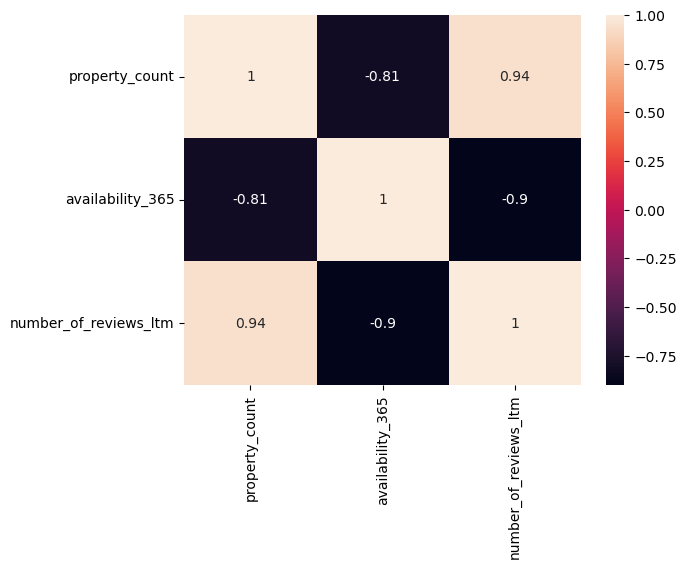

In [47]:
df1 = pd.DataFrame(availability_yearly_with_count_reviews_ltm_sorted)
sns.heatmap(df1[['property_count', 'availability_365', 'number_of_reviews_ltm']].corr(method = 'spearman'), annot = True)

1. availability_365 memiliki korelasi negatif yang kuat dengan property_count (-0.81) dan number_of_reviews_ltm (-0.9). Hal ini menunjukkan bahwa semakin banyak properti yang dimiliki (property_count) atau semakin banyak ulasan yang diterima dalam setahun terakhir (number_of_reviews_ltm), maka semakin rendah tingkat ketersediaan (availability_365) properti tersebut
1. Terdapat korelasi positif yang sangat kuat (0.94) antara property_count dan number_of_reviews_ltm. Ini berarti properti yang memiliki lebih banyak unit atau listing (property_count) cenderung menerima lebih banyak ulasan dalam setahun terakhir. Ini mungkin karena properti yang lebih besar atau yang memiliki lebih banyak unit dapat melayani lebih banyak tamu, sehingga mendapatkan lebih banyak ulasan

## 3. Korelasi Kolom yang Berhubungan terhadap Harga Sewa

In [49]:
import pandas as pd

# Assuming df is your DataFrame

# Menghitung rata-rata availability_365 dan rata-rata price per area
area_availability = df.groupby('area')['availability_365'].mean().reset_index().rename(columns={'availability_365': 'average_availability'})
area_price = df.groupby('area')['price'].mean().reset_index().rename(columns={'price': 'average_price'})
number_of_reviews_area = df.groupby('area')['number_of_reviews'].mean().reset_index().rename(columns={'number_of_reviews': 'number_of_reviews_area'})

# Menggabungkan rata-rata availability_365, rata-rata price, jumlah tipe kamar unik, dan rata-rata jumlah review menjadi satu DataFrame
area_stats = pd.merge(area_availability, area_price, on='area')
area_stats = pd.merge(area_stats, number_of_reviews_area, on='area')

# Menampilkan DataFrame hasil penggabungan
print(area_stats)

# Menghitung korelasi antara rata-rata availability_365 dan rata-rata price
correlation_availability_price = area_stats['average_availability'].corr(area_stats['average_price'])
print("Korelasi antara rata-rata availability_365 dan rata-rata price:", correlation_availability_price)



                    area  average_availability  average_price  \
0        Central Bangkok            235.475807    1727.562234   
1           East Bangkok            264.061358    1236.312010   
2          North Bangkok            252.082569    1209.036697   
3  Outer Western Bangkok            267.729730    1292.162162   
4          South Bangkok            253.012351    1372.650885   
5           West Bangkok            253.057236    1350.725266   

   number_of_reviews_area  
0               19.174463  
1                7.382507  
2               13.809008  
3               10.369369  
4               17.611363  
5               11.432543  
Korelasi antara rata-rata availability_365 dan rata-rata price: -0.8170898927028503


In [64]:
area_stats

,area,average_availability,average_price,number_of_reviews_area,bin_average_availability,bin_number_of_reviews_area
0,Central Bangkok,235.475807,1727.562234,19.174463,"(235.475, 252.702]","(15.076, 19.174]"
1,East Bangkok,264.061358,1236.312010,7.382507,"(256.725, 267.73]","(7.382, 11.078]"
2,North Bangkok,252.082569,1209.036697,13.809008,"(235.475, 252.702]","(11.078, 15.076]"
3,Outer Western Bangkok,267.729730,1292.162162,10.369369,"(256.725, 267.73]","(7.382, 11.078]"
4,South Bangkok,253.012351,1372.650885,17.611363,"(252.702, 256.725]","(15.076, 19.174]"
5,West Bangkok,253.057236,1350.725266,11.432543,"(252.702, 256.725]","(11.078, 15.076]"


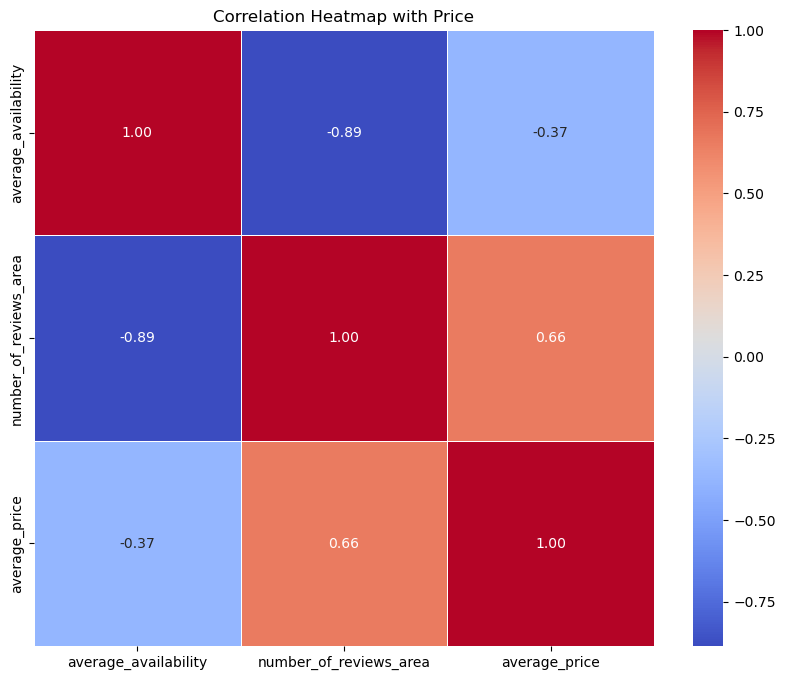

In [50]:
# Create a correlation matrix
correlation_matrix = area_stats[['average_availability', 'number_of_reviews_area','average_price']].corr(method='spearman')

# Set up the matplotlib figure
plt.figure(figsize=(10, 8))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)

# Set the title
plt.title('Correlation Heatmap with Price')

# Show the plot
plt.show()

Terdapat korelasi positif (0.66) antara number_of_reviews_area dan average_price. Ini menunjukkan bahwa area dengan harga rata-rata yang lebih tinggi cenderung memiliki lebih banyak ulasan

Korelasi negatif (-0.37) antara average_availability dan average_price menunjukkan bahwa area dengan harga rata-rata yang lebih tinggi cenderung memiliki ketersediaan yang lebih rendah.

Column: average_availability


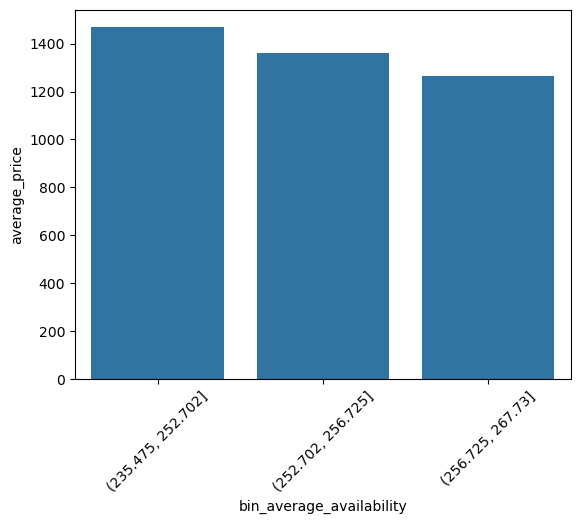

Column: number_of_reviews_area


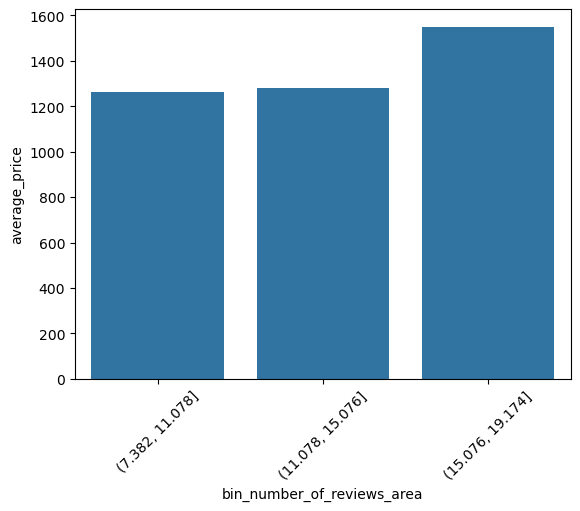

In [51]:
# List of columns to process
cols = ['average_availability','number_of_reviews_area']

# Iterate over the columns
for col in cols:
    print(f'Column: {col}')
    area_stats[f'bin_{col}'] = pd.qcut(area_stats[col], 3, duplicates='drop')
    sns.barplot(data=area_stats.groupby(f'bin_{col}')['average_price'].mean().reset_index(), x=f'bin_{col}', y='average_price')
    plt.xticks(rotation=45)
    plt.show()

## Conclusion

1. Kesimpulan utama dari hasil ini adalah bahwa ada variasi harga yang cukup signifikan di seluruh area Bangkok, dengan Central Bangkok memiliki variasi harga terbesar. Ini mungkin mencerminkan perbedaan dalam jenis penginapan yang tersedia, dari penginapan mewah hingga yang lebih terjangkau, serta perbedaan dalam permintaan dan penawaran di setiap area.
1. Insight ini dapat membantu pengelola penginapan, investor, dan perencana kota untuk mengambil keputusan yang lebih baik dalam mengelola dan mengembangkan industri pariwisata dan perhotelan di Bangkok.
    Pengelola properti juga dapat menggunakan informasi ini untuk memahami bagaimana faktor-faktor seperti jumlah properti dan ulasan mempengaruhi Popularitas. 
1. Ketersediaan dan Harga: Ada kecenderungan bahwa area dengan harga rata-rata yang lebih tinggi memiliki ketersediaan yang lebih rendah. Ini bisa disebabkan oleh permintaan yang tinggi di area dengan harga lebih tinggi, sehingga ketersediaan menjadi terbatas.

## Recommendation

1. Strategi Pengelolaan Penginapan:

    a. Pengelola penginapan di Central Bangkok mungkin dapat mempertimbangkan untuk meningkatkan harga atau mengoptimalkan pemesanan untuk memanfaatkan tingginya permintaan.
    
    b. Sebaliknya, pengelola penginapan di Outer Western Bangkok mungkin perlu mencari cara untuk meningkatkan daya tarik penginapan mereka, seperti meningkatkan pemasaran, menawarkan diskon, atau meningkatkan fasilitas untuk menarik lebih banyak tamu.
1. Properti dengan tingkat ketersediaan yang rendah tetapi memiliki banyak ulasan mungkin berada di lokasi yang sangat diminati atau memiliki layanan yang sangat baik. Strategi pemasaran bisa difokuskan pada promosi kualitas layanan dan testimonial dari tamu agar dapat mempertahankan Popularitas dari penginapan tersebut
1. Rekomendasi:
    a. Mengingat area dengan harga yang lebih tinggi cenderung memiliki ketersediaan yang lebih rendah, pemilik properti atau pengelola dapat mempertimbangkan untuk menaikkan harga di area tersebut karena permintaan tinggi. Hal tersebut juga harus diimbangi dengan menjaga kualitas pelayanan yang baik.
    b. Untuk penginapan yang ketersediaannya tinggi dapat meningkatkan pemasaran dengan menggunakan media sosial, lalu dengan melakukan promosi dengan menawarkan paket harga dengan lebih murah dan memberikan pelayanan yang lebih baik lagi.

In [52]:
df.sample(10)

,index,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,area,popularity
13023,14314,724491972681660067,Cozy 1 BR/3 min walk to BTS Thonglor,152018136,Tony,Khlong Toei,13.722519,100.576959,Entire home/apt,1594,2,6,2022-12-16,2.65,12,142,6,Central Bangkok,Popular
3609,3877,20347136,Happy Room in the City Center of Bangkok,126765393,Alfred,Vadhana,13.747480,100.557330,Entire home/apt,1305,28,17,2020-03-25,0.26,1,60,0,Central Bangkok,Very Popular
12408,13630,685117420886446494,Room in the center of Bangkok with a rooftop pool,172372709,Stasya,Bang Rak,13.728030,100.529620,Private room,2050,2,0,Not Reviewed,0.00,1,361,0,Central Bangkok,Non Popular
4467,4837,24477507,"Ideal location, Private double room AC",83023551,Yaya,Bang Rak,13.725260,100.521680,Private room,475,1,4,2019-02-18,0.07,8,364,0,Central Bangkok,Non Popular
1091,1167,7719234,Vanda Home Sweet Home,40558003,Vanda,Chatu Chak,13.804920,100.587210,Entire home/apt,1250,1,0,Not Reviewed,0.00,1,365,0,North Bangkok,Non Popular
7490,8173,35812105,Business suit.Luxury sky swimming pool. EM 2 Siam,115758511,JSHome Luxury,Khlong Toei,13.716040,100.570460,Entire home/apt,2457,1,7,2022-10-20,0.17,22,78,5,Central Bangkok,Very Popular
11824,12977,641770008822766413,Brand New Studio Near MRT Sirikit (6),125327411,Prem,Khlong Toei,13.723400,100.560940,Private room,1209,1,3,2022-12-13,0.67,24,365,3,Central Bangkok,Non Popular
2478,2661,16138220,Contemporary private capsule suite up to 6 person,92567498,The BOB Hostel,Vadhana,13.740140,100.589250,Shared room,1500,1,38,2019-03-01,0.53,5,365,0,Central Bangkok,Non Popular
1327,1419,9286547,24HRS Front desk with Clean Triple room in Siam,46902414,Hi! We Are The Fifth Residence,Parthum Wan,13.750560,100.520160,Hotel room,1785,1,19,2019-07-24,0.22,4,356,0,Central Bangkok,Non Popular
6032,6587,31078012,Near The Grand Palace/ASOK Station/Sukhumvit#01,52161947,Noons,Khlong Toei,13.736150,100.556990,Entire home/apt,2057,1,60,2022-12-19,1.23,99,361,6,Central Bangkok,Non Popular


In [55]:
# df.to_csv('CleanAirbnb.csv', index=False)

In [62]:
# df1.to_csv('HeatmapAnalisa1.csv', index=False)

In [63]:
# area_stats.to_csv('HeatBinAnalisa3.csv', index=False)